In [120]:
import pandas as pd
import os

In [121]:
path = os.getcwd()
ads_df = pd.read_csv(f"{path}/ads_data_transformed.csv")
m_df = pd.read_csv(f"{path}/moderators_data.csv")

In [122]:
# filling NaN values in queue market with the devlivery mkt instead
reclean_queueMkt = []

for i in range(len(ads_df['queue_market'])):
    qMkt = ads_df['queue_market'].iloc[i]
    
    if ads_df['queue_market'].iloc[i] is None:
        reclean_queueMkt.append([ads_df['delivery_country'].iloc[i]])

    elif ads_df['queue_market'].iloc[i] == "Others":
        reclean_queueMkt.append(["Other"])
    
    elif ads_df['queue_market'].iloc[i] == "Other":
        reclean_queueMkt.append(["Other"])
    
    elif type(ads_df['queue_market'].iloc[i]) is float:
        reclean_queueMkt.append([ads_df['delivery_country'].iloc[i]])
        
    elif ads_df['queue_market'].iloc[i] == '':
        reclean_queueMkt.append([ads_df['delivery_country'].iloc[i]])

    # creates list 
    elif len(ads_df['queue_market'].iloc[i]) > 2:
        
        if 'USCA' in qMkt:
            x = ['US','CA']
            reclean_queueMkt.append(x)
        
        elif  'US&CA' in qMkt:
            x = ['US','CA']
            reclean_queueMkt.append(x)

        elif 'KW/AE/SA' in qMkt:
            x = ['KW','AE','SA']
            reclean_queueMkt.append(x)

        elif 'MENA' in qMkt:
            reclean_queueMkt.append([ads_df['delivery_country'].iloc[i]])
        
        else:
            x = [qMkt]
            reclean_queueMkt.append(x)

    else:
        x = [qMkt]
        reclean_queueMkt.append(x)
            
ads_df['queue_market'] = reclean_queueMkt
ads_df

,p_date,ad_id,delivery_country,queue_market,punish_num,latest_punish_begin_date,ad_revenue,avg_ad_revenue,start_time,baseline_st,product_line,task_type_en,punish_after_start_time,final_score,final_score_srt
0,20230807,1747578422390810,US,"[US, CA]",1.0,2023-07-24,8.463992,8.321523,2022-10-24 14:36:00.000000,1.78,Auction Ads,auction_relation,272,1.000000,1.000000
1,20230807,1758543228094480,SA,[SA],1.0,2023-06-14,6.667461,5.710993,2023-02-22 15:50:00.000000,1.67,RIE,Ad Group Recall (Merged),111,0.757445,0.757445
2,20230807,1738303151826990,AU,[AU],2.0,2023-07-24,1.147773,1.521922,2022-07-14 05:00:00.000000,1.84,Auction Ads,auction_relation,374,0.957360,0.957360
3,20230807,1738303920938010,NZ,[NZ],2.0,2023-07-24,1.869955,1.521922,2022-07-14 05:16:00.000000,1.58,Auction Ads,auction_relation,374,0.909398,0.909398
4,20230807,1738304016410620,NZ,[NZ],2.0,2023-07-24,1.111265,1.521922,2022-07-14 05:17:00.000000,1.58,Auction Ads,auction_relation,374,0.909397,0.909397
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40674,20230807,1773472206047230,VN,[VN],0.0,2000-01-01,0.736146,0.000000,2023-09-07 22:23:55.948341,0.54,Non-Auction Ads,Promote,0,0.038810,0.038810
40675,20230807,1773607712030720,BR,[BR],0.0,2000-01-01,0.736146,0.000000,2023-09-07 22:23:55.948341,0.54,Non-Auction Ads,Promote,0,0.038810,0.038810
40676,20230807,1773589699308540,BE,[BE],0.0,2000-01-01,0.736146,0.000000,2023-09-07 22:23:55.948341,0.54,Non-Auction Ads,Promote,0,0.038810,0.038810
40677,20230807,1773530511220730,TR,[TR],0.0,2000-01-01,0.736146,0.000000,2023-09-07 22:23:55.948341,0.54,Non-Auction Ads,Promote,0,0.038810,0.038810


In [123]:
all_mkts = []

for i in range(len(m_df["market"])):
    l = m_df["market"].iloc[i]
    temp = l.split('"')

    new = []
    for each in temp:
        if "[" not in each and "]" not in each and "," not in each:
            new.append(each)

            if each not in all_mkts:
                all_mkts.append(each)
    
    m_df.at[i, "market"] = new

m_df["market"]

0                                                [US, CA]
1                                        [PL, PT, GB, IL]
2                                            [GB, IT, IE]
3                                                [US, CA]
4       [SA, OM, BH, QA, AE, DZ, JO, IQ, KW, TN, MA, L...
                              ...                        
1409                                                 [DK]
1410                                                 [ID]
1411                                             [GB, IE]
1412                                              [OTHER]
1413                                                 [IT]
Name: market, Length: 1414, dtype: object

In [124]:
import math

# Load the Excel file into a dictionary of dataframes
excel_file = pd.ExcelFile('updated_mods_by_market.xlsx')  # Replace with your Excel file's path

# Initialize an empty dictionary to store dataframes
mkt_dict = {}

# Iterate through each sheet in the Excel file
for sheet_name in excel_file.sheet_names:
    # Read the sheet into a dataframe
    sheet_data = excel_file.parse(sheet_name)

    sheet_data.drop(columns=['Unnamed: 0'], inplace=True)
    sheet_data["no_of_ads"] = 0
    sheet_data["max_ads"] = sheet_data["productivity"]*sheet_data["utilisation"]
    sheet_data["max_ads"] = [math.floor(x) for x in sheet_data["max_ads"]]
    
    # Store the dataframe in the dictionary with the sheet name as the key
    mkt_dict[sheet_name] = sheet_data

mkt_dict["SA"]

,moderator,market,productivity,utilisation,handling_time,accuracy,final_score,no_of_ads,max_ads
0,2258595,"[""SA"", ""OM"", ""BH"", ""QA"", ""AE"", ""DZ"", ""JO"", ""IQ...",0.000000,0.000000,0,0.333,0.332914,0,0
1,1749551102734338,"[""SA"", ""OM"", ""BH"", ""QA"", ""JO"", ""IQ"", ""KW"", ""MA...",394.541395,0.751938,114562,0.404,0.540424,0,296
2,7363167,"[""SA"", ""BH"", ""OM"", ""QA"", ""AE"", ""JO"", ""IQ"", ""KW...",254.820000,0.540042,2578531,0.500,0.549571,0,137
3,3500723,"[""SA"", ""OM"", ""QA"", ""AE"", ""TR"", ""PK"", ""KW"", ""MA...",0.000000,0.000000,0,0.608,0.607842,0,0
4,1958955,"[""SA"", ""OM"", ""BH"", ""AE"", ""KW"", ""MA"", ""EG"", ""LB""]",951.290000,0.735760,117912,0.656,0.765837,0,699
...,...,...,...,...,...,...,...,...,...
72,1671848935147526,"[""SA""]",0.000000,0.000000,0,0.969,0.968749,0,0
73,1671849021974534,"[""ZA"", ""OM"", ""BH"", ""SA"", ""QA"", ""JO"", ""IQ"", ""PK...",175.659429,0.867257,122985,0.974,0.973929,0,152
74,1746474353707041,"[""SA"", ""BH"", ""OM"", ""QA"", ""JO"", ""IQ"", ""KW"", ""MA...",531.680000,0.750000,67500,1.000,0.999939,0,398
75,1668385955785733,"[""SA"", ""ME""]",298.673778,0.815556,125421,1.000,0.999923,0,243


In [125]:
ads_df.head(10)

,p_date,ad_id,delivery_country,queue_market,punish_num,latest_punish_begin_date,ad_revenue,avg_ad_revenue,start_time,baseline_st,product_line,task_type_en,punish_after_start_time,final_score,final_score_srt
0,20230807,1747578422390810,US,"[US, CA]",1.0,2023-07-24,8.463992,8.321523,2022-10-24 14:36:00.000000,1.78,Auction Ads,auction_relation,272,1.000000,1.000000
1,20230807,1758543228094480,SA,[SA],1.0,2023-06-14,6.667461,5.710993,2023-02-22 15:50:00.000000,1.67,RIE,Ad Group Recall (Merged),111,0.757445,0.757445
2,20230807,1738303151826990,AU,[AU],2.0,2023-07-24,1.147773,1.521922,2022-07-14 05:00:00.000000,1.84,Auction Ads,auction_relation,374,0.957360,0.957360
3,20230807,1738303920938010,NZ,[NZ],2.0,2023-07-24,1.869955,1.521922,2022-07-14 05:16:00.000000,1.58,Auction Ads,auction_relation,374,0.909398,0.909398
4,20230807,1738304016410620,NZ,[NZ],2.0,2023-07-24,1.111265,1.521922,2022-07-14 05:17:00.000000,1.58,Auction Ads,auction_relation,374,0.909397,0.909397
5,20230807,1738304421208090,NZ,[NZ],2.0,2023-07-24,0.942444,1.521922,2022-07-14 05:24:00.000000,1.58,Auction Ads,auction_relation,374,0.909397,0.909397
6,20230807,1738304605976620,NZ,[NZ],2.0,2023-07-24,0.950173,1.521922,2022-07-14 05:26:00.000000,1.58,Auction Ads,auction_relation,374,0.909397,0.909397
7,20230807,1724385503656970,FI,[Other],1.0,2023-06-27,4.366008,4.707392,2022-02-10 14:07:00.000000,1.62,RIE,Ad Group Recall (Merged),501,1.000000,1.000000
8,20230807,1764813273437210,US,"[US, CA]",1.0,2023-07-05,4.717247,5.121756,2023-05-02 20:51:00.000000,1.78,Auction Ads,auction_relation,63,0.711377,0.711377
9,20230807,1763583923607580,NZ,[NZ],2.0,2023-07-24,1.137858,1.521922,2023-04-19 06:05:00.000000,1.58,Auction Ads,auction_relation,95,0.690845,0.690845


In [129]:
# get best match between ad and moderator across all mkt segment
def get_ad_moderator_match(ad_id, ad_score, queue_mkts, mkt_dict):

    mismatch_score = 1
    final_moderator = ""
    moderator_score = 0
    mkt = ""

    # loop through each ad mkt
    for i in range(len(queue_mkts)):

        mkt_df = mkt_dict[queue_mkts[i]]
        # get best match between ad and moderator
        moderator, m_score, scores_diff = get_best_match(ad_score, mkt_df)

        # check if mismatch score is the lowest amongst all mkts
        if scores_diff < mismatch_score:
            mismatch_score = scores_diff
            final_moderator = moderator
            moderator_score = m_score
            mkt = queue_mkts[i]

    # print(mkt)
    # print(ad_id)
    # print(final_moderator)

    if int(mkt_dict[mkt].loc[mkt_dict[mkt]["moderator"] == final_moderator, "max_ads"]) > 0:
        mkt_dict[mkt].loc[mkt_dict[mkt]["moderator"] == final_moderator, "max_ads"] -= 1
    else:
        mkt_dict[mkt].loc[mkt_dict[mkt]["moderator"] == final_moderator, "no_of_ads"] += 1
    
    mismatch = abs(ad_score - moderator_score)

    #  add to output df
    new_row = {
        "ad_id": ad_id,
        "moderator_id": final_moderator,
        "ad_score": ad_score,
        "moderator_score": moderator_score,
        "mismatch_score": mismatch
    }

    return new_row, mkt_dict


# get match between ad and moderator in the mkt segment
def get_best_match(ad_score, mkt_df):

    step = (1/40679)
    
    scores_diff = 1
    m_score = 0
    moderator = ""

    print("-----------------------------------")

    for i in range(len(mkt_df["final_score"])):
        score = mkt_df["final_score"].iloc[i]
        
        if mkt_df["max_ads"].iloc[i] > 0:
            diff = abs(ad_score - score)

            if diff < scores_diff:
                scores_diff = diff
                moderator = mkt_df["moderator"].iloc[i]
                m_score = score
        else:
            diff = abs(ad_score - score) + step*mkt_df["no_of_ads"].iloc[i]

            print(diff)
            if diff < scores_diff:
                scores_diff = diff
                moderator = mkt_df["moderator"].iloc[i]
                m_score = score


    print(f"ad score: {ad_score}")
    print(f"moderator score: {m_score}")
    print(f"moderator: {moderator}")
    print(f"score diff: {scores_diff}")

    print("-----------------------------------")

    if moderator == "":
        raise ValueError("No matching moderator found.")
    
    return moderator, m_score, scores_diff

In [130]:
output = []

for i in range(len(ads_df["final_score"])):

    ad_id = ads_df["ad_id"].iloc[i]
    ad_score = ads_df["final_score"].iloc[i]
    queue_mkts = ads_df["queue_market"].iloc[i]

    result, new_mkt_dict = get_ad_moderator_match(ad_id, ad_score, queue_mkts, mkt_dict)
    mkt_dict = new_mkt_dict
    output.append(result)

mapping_df = pd.DataFrame(output)
mapping_df

-----------------------------------
0.6077220573492991
0.6494919193110843
0.539131900638528
0.6142969156762218
0.605984497786368
0.5863612608510789
0.5276993777397151
0.4602136832264454
0.4501916919086795
0.4381948015775879
0.42919713382926933
0.4291914788969126
0.4202486314979962
0.40015548344541885
0.36623804229956103
0.3511927639686509
0.3441945779421807
0.32417499135100025
0.3161772511277774
0.12822596927400876
0.11822856066476573
0.052245663843761836
0.04524747781729155
0.04424773695636741
0.00025913907569796724
0.00025913907569796724
ad score: 1.0
moderator score: 1.0
moderator: 9616890
score diff: 0.0
-----------------------------------
-----------------------------------
0.6063945910890665
0.6126990396222382
0.604730779651704
0.5858696066806223
0.46018910051792256
0.45016710920015673
0.4381948015775879
0.42917255112074654
0.4291914788969126
0.4202240487894734
0.40015548344541885
0.3662134595910382
0.35116818126012805
0.3441699952336579
0.32417499135100025
0.3161772511277774
0.1

/var/folders/n5/nyw3dq1s69nd91ynn_2b589r0000gn/T/ipykernel_4867/2246503185.py:27: FutureWarning: Calling int on a single element Series is deprecated and will raise a TypeError in the future. Use int(ser.iloc[0]) instead
  if int(mkt_dict[mkt].loc[mkt_dict[mkt]["moderator"] == final_moderator, "max_ads"]) > 0:
/var/folders/n5/nyw3dq1s69nd91ynn_2b589r0000gn/T/ipykernel_4867/2246503185.py:27: FutureWarning: Calling int on a single element Series is deprecated and will raise a TypeError in the future. Use int(ser.iloc[0]) instead
  if int(mkt_dict[mkt].loc[mkt_dict[mkt]["moderator"] == final_moderator, "max_ads"]) > 0:
/var/folders/n5/nyw3dq1s69nd91ynn_2b589r0000gn/T/ipykernel_4867/2246503185.py:27: FutureWarning: Calling int on a single element Series is deprecated and will raise a TypeError in the future. Use int(ser.iloc[0]) instead
  if int(mkt_dict[mkt].loc[mkt_dict[mkt]["moderator"] == final_moderator, "max_ads"]) > 0:
/var/folders/n5/nyw3dq1s69nd91ynn_2b589r0000gn/T/ipykernel_4867/

-----------------------------------
0.3521460194491038
0.3362630789676059
0.3671517214684487
0.4131470269957592
0.42093868237823984
0.467803589299068
0.508802498448834
ad score: 0.4049701822878476
moderator score: 0.7378900128963493
moderator: 3515233
score diff: 0.3362630789676059
-----------------------------------
-----------------------------------
0.3521460194491038
0.3362876616761287
0.3671517214684487
0.4131470269957592
0.42093868237823984
0.467803589299068
0.508802498448834
ad score: 0.4049701822878476
moderator score: 0.7378900128963493
moderator: 3515233
score diff: 0.3362876616761287
-----------------------------------
-----------------------------------
0.3521460194491038
0.3363122443846515
0.3671517214684487
0.4131470269957592
0.42093868237823984
0.467803589299068
0.508802498448834
ad score: 0.4049701822878476
moderator score: 0.7378900128963493
moderator: 3515233
score diff: 0.3363122443846515
-----------------------------------
-----------------------------------
0.35214

/var/folders/n5/nyw3dq1s69nd91ynn_2b589r0000gn/T/ipykernel_4867/2246503185.py:27: FutureWarning: Calling int on a single element Series is deprecated and will raise a TypeError in the future. Use int(ser.iloc[0]) instead
  if int(mkt_dict[mkt].loc[mkt_dict[mkt]["moderator"] == final_moderator, "max_ads"]) > 0:
/var/folders/n5/nyw3dq1s69nd91ynn_2b589r0000gn/T/ipykernel_4867/2246503185.py:27: FutureWarning: Calling int on a single element Series is deprecated and will raise a TypeError in the future. Use int(ser.iloc[0]) instead
  if int(mkt_dict[mkt].loc[mkt_dict[mkt]["moderator"] == final_moderator, "max_ads"]) > 0:
/var/folders/n5/nyw3dq1s69nd91ynn_2b589r0000gn/T/ipykernel_4867/2246503185.py:27: FutureWarning: Calling int on a single element Series is deprecated and will raise a TypeError in the future. Use int(ser.iloc[0]) instead
  if int(mkt_dict[mkt].loc[mkt_dict[mkt]["moderator"] == final_moderator, "max_ads"]) > 0:
/var/folders/n5/nyw3dq1s69nd91ynn_2b589r0000gn/T/ipykernel_4867/

,ad_id,moderator_id,ad_score,moderator_score,mismatch_score
0,1747578422390810,9616890,1.000000,1.000000,0.000000
1,1758543228094480,3318739,0.757445,0.755731,0.001714
2,1738303151826990,5090932,0.957360,0.959651,0.002290
3,1738303920938010,2008658,0.909398,0.910739,0.001341
4,1738304016410620,2008658,0.909397,0.910739,0.001342
...,...,...,...,...,...
40674,1773472206047230,3831078,0.038810,0.555916,0.517106
40675,1773607712030720,1005827,0.038810,0.145084,0.106274
40676,1773589699308540,5683738,0.038810,0.535861,0.497051
40677,1773530511220730,3778633,0.038810,0.140719,0.101909


In [132]:
mapping_df["moderator_id"].nunique()

183

<Axes: >

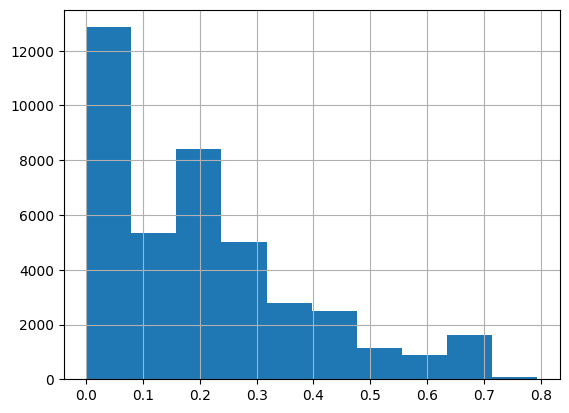

In [134]:
mapping_df["mismatch_score"].hist()

In [131]:
mkt_dict["Other"]

,moderator,market,productivity,utilisation,handling_time,accuracy,final_score,no_of_ads,max_ads
0,6233278,"[""ES"", ""OTHER"", ""GB""]",402.336667,0.805993,71696,0.795,0.806629,1393,0
1,1782229,"[""MX"", ""AR"", ""OTHER""]",130.960000,0.349635,21234,1.000,0.999815,320,0
2,3857259,"[""MX"", ""AR"", ""OTHER""]",74.283333,0.359417,26500,1.000,0.999808,320,0
3,3297271,"[""OTHER""]",0.000000,0.000000,0,0.000,0.000000,2400,0
